<h1>Principal Landmarks</h1>

The assignment instructions are as follows:

- processes all photos down to a size not exceeding 512 pixels in either width or height
- using principal components analysis, project your images down to a 2 dimensional representation
- visually inspect the 2D locations of each photo in the new space
- show the reconstruction from each low-dimensional representation
- finally pick a point that is far away from any known location and plot its reconstruction

If you perform any other image processing steps, please clearly note them in your report. This is meant to be a reasonably light-hearted assignment, so feel free to pick irreverent landmarks or use interesting image processing techniques to find artistic reconstructions. You may also try to conduct this assignment in three dimensions, but no higher!

Hand in a single pdf containing all your results and a short discussion of your findings. (Make sure to include: at least 10 of your small photos and their associated reconstructions; the scatterplot of all images in the 2D space, and where your new point is; and the reconstruction from your new point.)

<h2>Data Cleaning and Preprocessing</h2>

Thirty photos were taken over a timespan of 2pm - 6pm at Kaffa cafe, located in Buenos Aires. The photos were taken from inside the cafe, and are mostly similar except for small perturbations in the photo angle and the objects within the photo (people, cars, etc.). The lighting also changes as time passes through the day.

The photos originally had heights and widths of 3456 x 4608 pixels, and were resized to 390 x 512 pixels. Since the photos have 3 color channels (RGB), the shape of a single photo matrix is given as 390 x 512 x 3. After flattening the photo arrays, we get 30 photo arrays each with 390 x 512 x 3 = 599040 columns. This translates to each photo having 599040 predictor features if being used in a machine learning context.

In [2]:
#import libraries
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread_collection
from skimage.transform import resize
import seaborn as sns
sns.set()

#my path 
photo_dir = 'Photos/*.jpg'

#creating a collection with the available images
photo_col = imread_collection(photo_dir)

print(f"Number of pictures: {len(photo_col)}.")
print(f"Photo dimensions: {photo_col[0].shape}")

Number of pictures: 30.
Photo dimensions: (3456, 4608, 3)


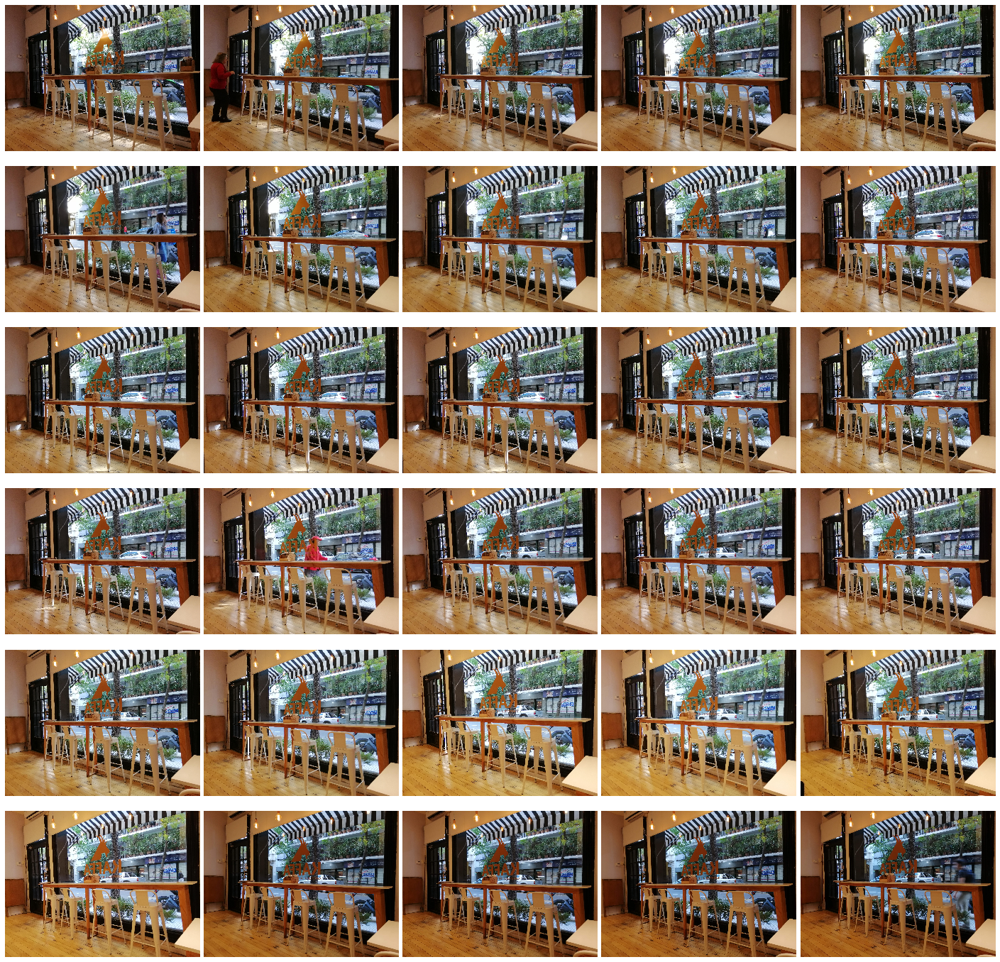

In [6]:
#display all the photos
fig, ax = plt.subplots(6, 5, figsize=(25, 25),
                       subplot_kw={'xticks':[], 'yticks':[]},
                       gridspec_kw=dict(hspace=0.02, wspace=0.02))

i = 0
for row in range(6):
    for col in range(5):
        ax[row, col].imshow(photo_col[i])
        i += 1

In [7]:
#height and width of resized image
new_height = 390
new_width = 512
    
#resize images in dataset
photos_resized = [resize(photo_col[i],(new_height,new_width), mode='constant', anti_aliasing=True, anti_aliasing_sigma=None) for i in range(len(photo_col))]


Text(0.5,1,'Resized photo (dim=((390, 512, 3)))')

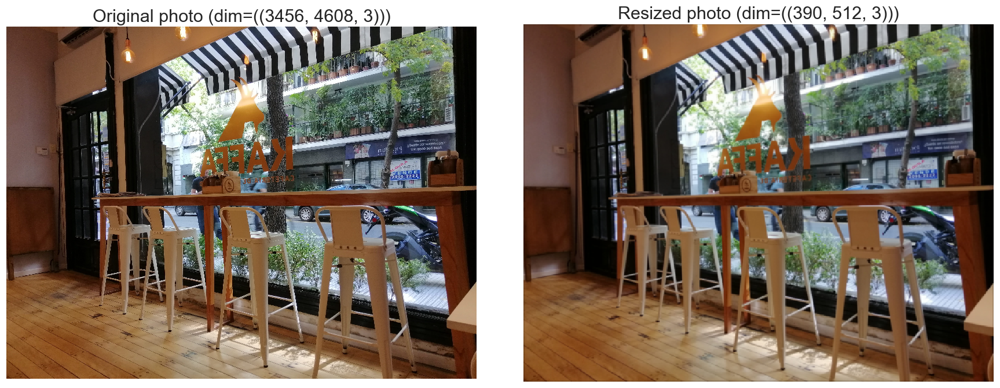

In [8]:
#compare resized image vs original image
fig, ax = plt.subplots(1, 2, figsize=(20, 8), dpi=110,
                       subplot_kw={'xticks':[], 'yticks':[]},
                       gridspec_kw=dict(hspace=0.1, wspace=0.1))

ax[0].imshow(photo_col[0])
ax[0].set_title(f"Original photo (dim=({photo_col[0].shape}))", size=20)

ax[1].imshow(photos_resized[0])
ax[1].set_title(f"Resized photo (dim=({photos_resized[0].shape}))", size=20)


In [9]:
#Reshape images to flattened array
photos_arr = np.array([i.flatten() for i in photos_resized])

print('Photos matrix shape:',photos_arr.shape)

Photos matrix shape: (30, 599040)


<h2>Dimensionality Reduction using PCA</h2>

The photos were reduced from 599040 dimensions to 2 dimensions using the principal component analysis method (PCA). The 2 dimensions (represented by 2 principal components derived from the PCA processing) were then plotted as a scatter plot to see if there were any interesting patterns.

Various images were reconstructed using random points from the scatter plot so that the effect of the two principal components could be analyzed individually.

In [10]:
from sklearn.decomposition import PCA
import pandas as pd

#Use randomized svd_solver to approx first N Principle Components much quicker than standard PCA
#useful for high-dimensional data
pca = PCA(n_components = 2, svd_solver='randomized')
pca_components = pca.fit_transform(photos_arr)
print(f"Ratio of explained variance by the principal components: {pca.explained_variance_ratio_}")

pca_df = pd.DataFrame(data = pca_components, columns = ['PC 1', 'PC 2'])
pca_df.head()

Ratio of explained variance by the principal components: [0.15713406 0.14140331]


,PC 1,PC 2
0,-22.015896,25.329084
1,-28.844690,1.091722
2,10.054586,15.360434
3,45.936667,-45.935784
4,16.530778,23.233039


In [11]:
#temporarily disable logging to hide message of:
#"Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers)."
import logging
logger = logging.getLogger()
old_level = logger.level
logger.setLevel(100)

Text(0,0.5,'2-dim\nreconstruction')

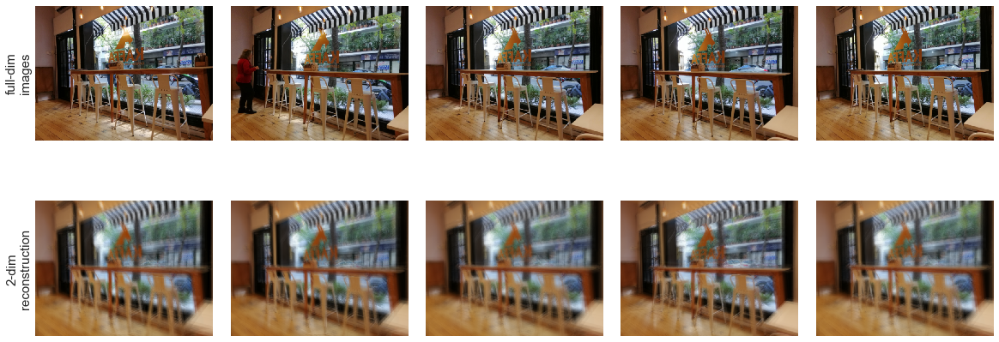

In [12]:
#reconstruct images with 2 principal components
pca_projected = pca.inverse_transform(pca_components)

# Plot the results
fig, ax = plt.subplots(2, 5, figsize=(20, 8),
                       subplot_kw={'xticks':[], 'yticks':[]},
                       gridspec_kw=dict(hspace=0.1, wspace=0.1))
for i in range(5):
    ax[0, i].imshow(photos_arr[i].reshape(new_height,new_width,3))
    ax[1, i].imshow(pca_projected[i].reshape(new_height,new_width,3))
    
ax[0, 0].set_ylabel('full-dim\nimages',size=15)
ax[1, 0].set_ylabel('2-dim\nreconstruction',size=15)

Text(0,0.5,'PC 2')

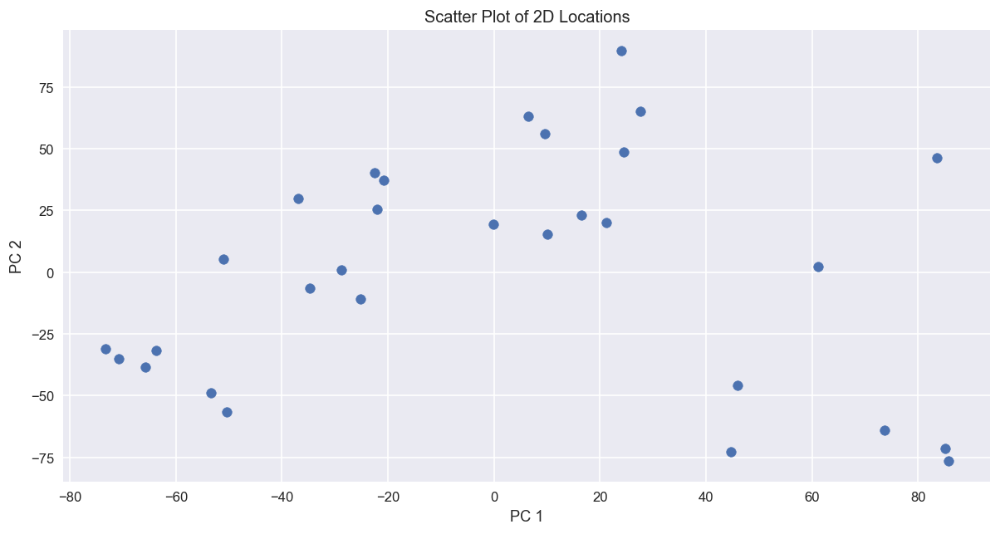

In [13]:
plt.figure(figsize=(12,6), dpi=120)
plt.scatter(pca_df['PC 1'], pca_df['PC 2'])
plt.title("Scatter Plot of 2D Locations")
plt.xlabel("PC 1")
plt.ylabel("PC 2")

From the scatter plot, it is possible to make out a vaguely parabolic shape with the peak around (20, 75). 

To experiment with some reconstructions, I decided to divide the plot up into four quadrants (top left, top right, bottom left, bottom right), and plot a few random points from each quadrant to analyze the effects of the different principal components.

Images were also reconstructed along the x and y-axis to observe the effect of linearly increasing either PC 1 or PC 2.

In [19]:
#points to be plotted
top_left = np.array([[-500,500],
                     [-500,250],
                     [-250,250],
                     [-50,500],
                     [-50,250]])

top_right = np.array([[50,250],
                      [50,500],
                      [250,250],
                      [500,250],
                      [500,500]])

bottom_left = np.array([[-500,-500],
                         [-500,-250],
                         [-250,-250],
                         [-50,-500],
                         [-50,-250]])

bottom_right = np.array([[50,-250],
                        [50,-500],
                        [250,-250],
                        [500,-250],
                        [500,-500]])

#plotting data across x-axis
x_points = np.array([[-500,0],[-400,0],[-300,0],[-200,0],[-100,0],
                     [100,0],[200,0],[300,0],[400,0],[500,0]])

#plotting data across y-axis
y_points = np.array([[0,-500],[0,-400],[0,-300],[0,-200],[0,-100],
                     [0,100],[0,200],[0,300],[0,400],[0,500]])


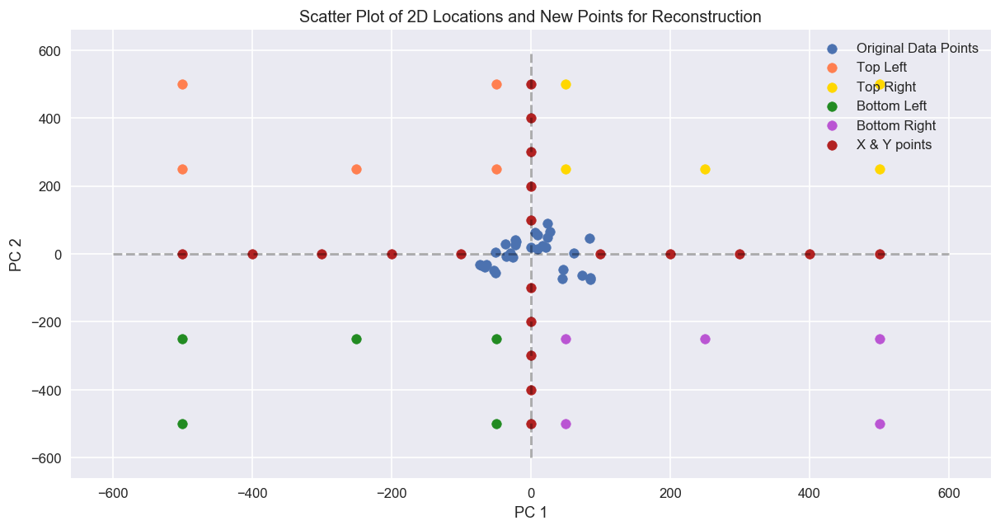

In [21]:
plt.figure(figsize=(12,6), dpi=120)
plt.scatter(pca_df['PC 1'], pca_df['PC 2'], label='Original Data Points')

#plot the 4 quadrants
plt.scatter(top_left[:,0], top_left[:,1], color='coral', label="Top Left")
plt.scatter(top_right[:,0], top_right[:,1], color='gold', label="Top Right")
plt.scatter(bottom_left[:,0], bottom_left[:,1], color='forestgreen', label="Bottom Left")
plt.scatter(bottom_right[:,0], bottom_right[:,1], color='mediumorchid', label="Bottom Right")

#plot x points and y points
plt.scatter(x_points[:,0], x_points[:,1], color='firebrick', label="X & Y points")
plt.scatter(y_points[:,0], y_points[:,1], color='firebrick')

#plot x-axis and y-axis
plt.hlines(0,-600,600, linestyle="dashed", alpha=0.3)
plt.vlines(0,-600,600, linestyle="dashed", alpha=0.3)

#title, labels, legend
plt.title("Scatter Plot of 2D Locations and New Points for Reconstruction")
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.legend()

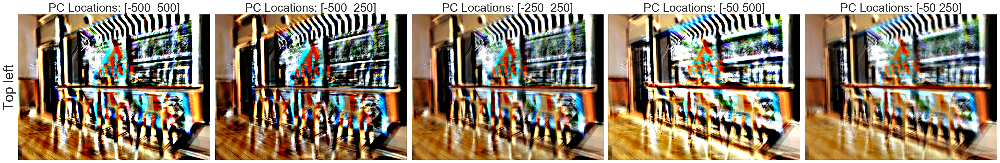

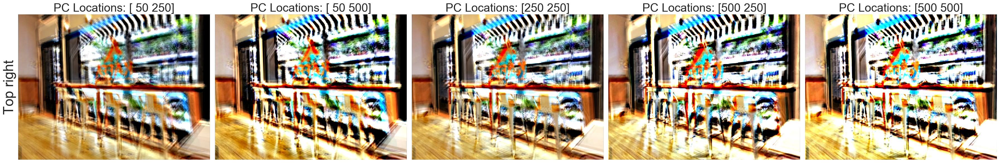

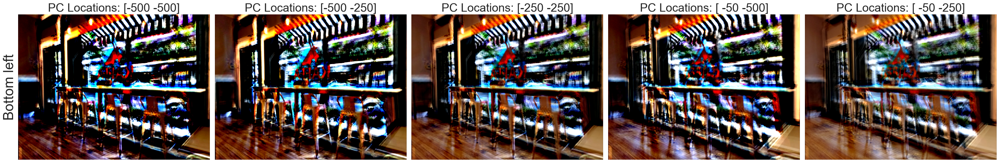

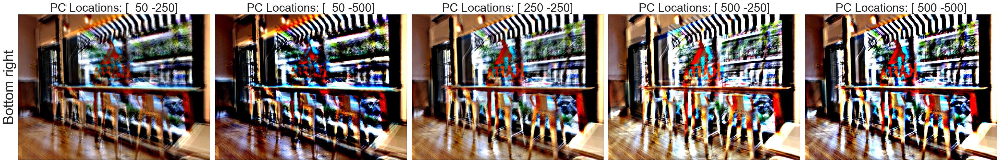

In [22]:
def pca_reconstruct(points, title):
    '''
    Takes in a numpy array of (x,y) points and reconstructs them according
    to the pca model defined earlier.
    '''
    reconstruction = pca.inverse_transform(points)

    plt.figure(figsize=(30,15), dpi=120)
    
    for i in range(len(reconstruction)):
        plt.subplot(1,len(reconstruction),i+1)
        if i == 0: plt.ylabel(f"{title}", size=30)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.title(f"PC Locations: {points[i]}", size=25)
        img = reconstruction[i].reshape(new_height,new_width,3)
        plt.imshow(img)
        
    plt.tight_layout()
    plt.show()

#reconstruct images from points of all 4 quadrants
pca_reconstruct(top_left, "Top left")
pca_reconstruct(top_right, "Top right")
pca_reconstruct(bottom_left, "Bottom left")
pca_reconstruct(bottom_right, "Bottom right")

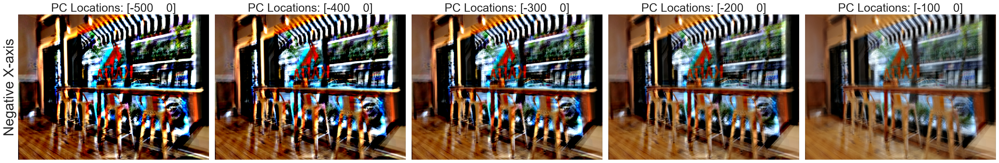

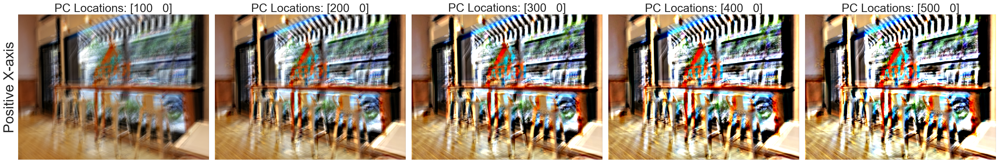

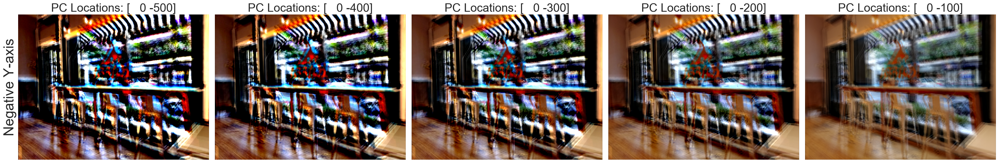

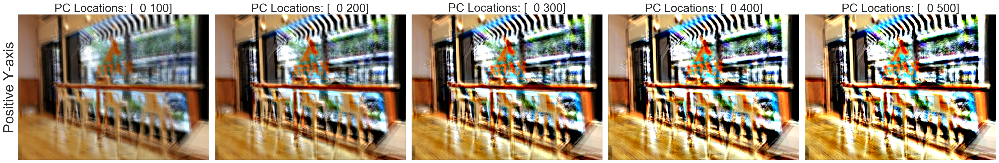

In [163]:
#reconstruct images along x and y-axis
pca_reconstruct(x_points[:5], "Negative X-axis")
pca_reconstruct(x_points[5:], "Positive X-axis")
pca_reconstruct(y_points[:5], "Negative Y-axis")
pca_reconstruct(y_points[5:], "Positive Y-axis")


In [23]:
#reenable logging
logger.setLevel(old_level)

<h2>Results Analysis</h2>

The points nearer to the original data points (centered around the origin) look more visually similar to the original pictures (as expected), and the further away the points are, the more artificial and "chaotic" the reconstructed images start to become.

<h3>Analyzing Reconstructed Images Along the X-axis (PC 1)</h3>

The brightness of the image increases as the value of PC 1 increases. That is, images in the negative PC 1 value zone are darker vs images in the positive PC 1 value zone. The images also experience a sharp increase in contrast as they move further away from the origin.

<h3>Analyzing Reconstructed Images Along the Y-axis (PC 2)</h3>

The qualitative changes in the images are almost identical to the changes identified for varying values of PC 1. Images tend to become brighter as the value of PC 2 increases. That is, images in the negative PC 2 value zone are darker vs images in the positive PC 2 value zone. The images also experience a sharp increase in contrast as they move further away from the origin.

<h3>Analyzing the Four Quadrants</h3>

<h4>Top vs Bottom</h4>

The images reconstructed from the top left and right quadrants are significantly brighter than the images from the bottom left and right quadrants. This suggests that PC 2 (on the y-axis) has a stronger effect on the image brightness vs PC 1. The top images also appear to have brighter blue tones vs the bottom images, i.e. the color blue is highlighted brightly in the top images, but almost darkened and dulled in the bottom images. The lighting on the floor also has an orange tint to it vs the lighting in on the floor in the bottom pictures, which have a blue tint. This suggests that PC 2 is also influencing the RGB hues of the reconstructed images, though the exact manipulation that is occuring is unclear.

<h4>Left vs Right</h4>

The images reconstructed from the left quadrant are darker than the images in the right quadrant, though the difference in brightness isn't as stark as when comparing the reconstructions from the top and bottom quadrants. This suggests that PC 1's effect on brightness isn't as strong as PC 2's effect on brightness.